# Install torch

In [1]:
# Install dependencies
!pip install -q torch torchvision albumentations numpy opencv-python pycocotools tqdm ultralytics yolov8 matplotlib 


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.2/87.2 kB 3.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 22.3 MB/s eta 0:00:0000:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 953.5/953.5 kB 48.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 417.5/417.5 kB 31.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.9/86.9 kB 8.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 112.3/112.3 kB 9.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 60.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.6/6.6 MB 88.2 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 84.3 MB/s eta 0:00:00:00:01
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the followin

# Libraries

In [2]:
import os
import yaml
from ultralytics import YOLO
import zipfile
import glob
import numpy as np
import cv2
import matplotlib.pyplot as plt
from PIL import Image

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


# Dataset Extraction

In [3]:
# Function to zip and extract dataset
def create_zip(source_folder, destination_zip):
    with zipfile.ZipFile(destination_zip, 'w', zipfile.ZIP_DEFLATED) as zip_ref:
        for root, dirs, files in os.walk(source_folder):
            for file in files:
                file_path = os.path.join(root, file)
                zip_ref.write(file_path, arcname=os.path.relpath(file_path, source_folder))

def extract_zip(zip_file, destination_folder):
    with zipfile.ZipFile(zip_file, 'r') as zip_ref:
        zip_ref.extractall(destination_folder)

# Paths for dataset
source_folder = '/kaggle/input/taco-dataset-yolo-format'
destination_zip = '/kaggle/working/taco_dataset.zip'
destination_folder = '/kaggle/working/'

# Zip & Extract
create_zip(source_folder, destination_zip)
extract_zip(destination_zip, destination_folder)

# Remove zip file

In [4]:
!rm -rf /kaggle/working/taco_dataset.zip  

# Dataset config

In [5]:
# Define dataset configuration (data.yaml)
data_yaml = dict(
    train='/kaggle/working/train/images',
    val='/kaggle/working/valid/images',
    test='/kaggle/working/test/images',
    nc=18,
    names=['Aluminium foil', 'Bottle cap', 'Bottle', 'Broken glass', 'Can', 
           'Carton', 'Cigarette', 'Cup', 'Lid', 'Other litter', 'Other plastic', 
           'Paper', 'Plastic bag - wrapper', 'Plastic container', 'Pop tab', 
           'Straw', 'Styrofoam piece', 'Unlabeled litter']
)

# Save data.yaml file
with open('data.yaml', 'w') as outfile:
    yaml.dump(data_yaml, outfile, default_flow_style=False)

In [6]:
import yaml

with open('data.yaml', 'r') as f:
    data_info = yaml.safe_load(f)

print(f"Number of Classes: {data_info['nc']}")
print("Classes:", data_info['names'])


Number of Classes: 18
Classes: ['Aluminium foil', 'Bottle cap', 'Bottle', 'Broken glass', 'Can', 'Carton', 'Cigarette', 'Cup', 'Lid', 'Other litter', 'Other plastic', 'Paper', 'Plastic bag - wrapper', 'Plastic container', 'Pop tab', 'Straw', 'Styrofoam piece', 'Unlabeled litter']


Class Counts:
Aluminium foil: 142
Bottle cap: 1318
Bottle: 821
Broken glass: 376
Can: 714
Carton: 662
Cigarette: 2214
Cup: 583
Lid: 252
Other litter: 356
Other plastic: 751
Paper: 369
Plastic bag - wrapper: 2228
Plastic container: 145
Pop tab: 225
Straw: 371
Styrofoam piece: 304
Unlabeled litter: 1419


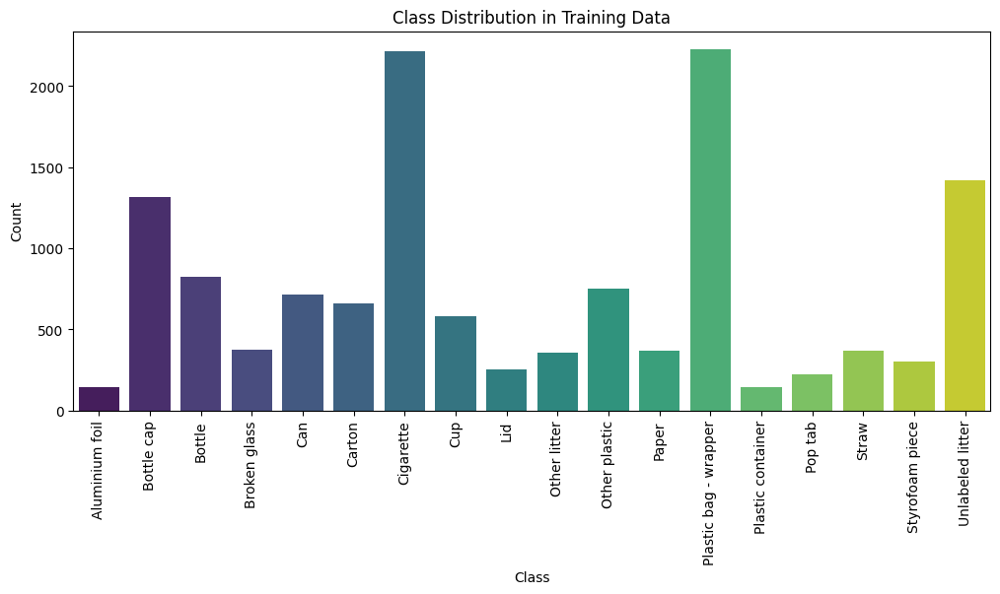

In [7]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from collections import Counter
import glob

# Get all label files
label_paths = glob.glob("/kaggle/working/train/labels/*.txt")  # Adjust if needed
class_counts = Counter()

# Read each label file and count occurrences of each class
for path in label_paths:
    with open(path, "r") as f:
        for line in f.readlines():
            class_id = int(line.split()[0])
            class_counts[class_id] += 1

# Convert to DataFrame for visualization
class_names = ['Aluminium foil', 'Bottle cap', 'Bottle', 'Broken glass', 'Can', 'Carton', 
               'Cigarette', 'Cup', 'Lid', 'Other litter', 'Other plastic', 'Paper', 
               'Plastic bag - wrapper', 'Plastic container', 'Pop tab', 'Straw', 
               'Styrofoam piece', 'Unlabeled litter']
df = pd.DataFrame({'Class': class_names, 'Count': [class_counts[i] for i in range(18)]})

# Print the class counts
print("Class Counts:")
for i, row in df.iterrows():
    print(f"{row['Class']}: {row['Count']}")

# Plot the distribution
plt.figure(figsize=(12, 5))
sns.barplot(x="Class", y="Count", data=df, palette="viridis")
plt.xticks(rotation=90)
plt.title("Class Distribution in Training Data")
plt.show()


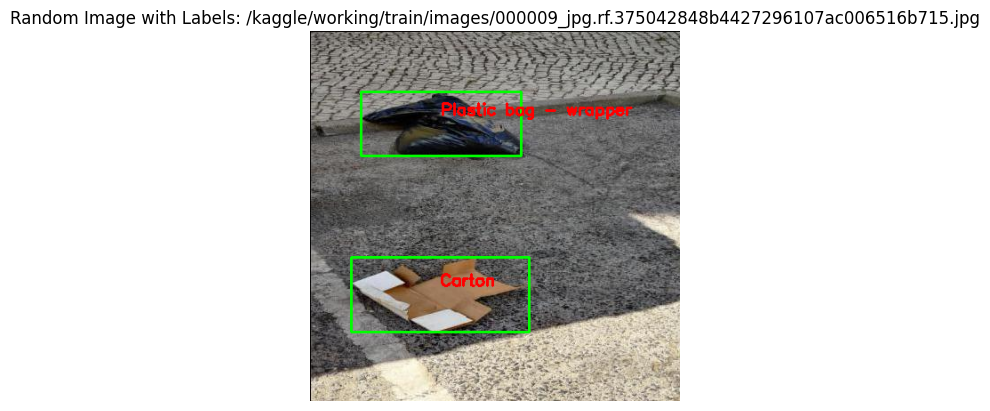

In [8]:
import random

# Function to show image with labels
def show_random_labeled_image():
    image_paths = glob.glob("/kaggle/working/train/images/*.jpg")  # Adjust format if needed
    label_paths = glob.glob("/kaggle/working/train/labels/*.txt")

    if not image_paths or not label_paths:
        print("No images or labels found.")
        return
    
    # Pick a random image
    random_image = random.choice(image_paths)
    label_path = random_image.replace("images", "labels").replace(".jpg", ".txt")

    # Load image
    img = cv2.imread(random_image)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Draw labels
    h, w, _ = img.shape
    with open(label_path, "r") as f:
        for line in f.readlines():
            class_id, x, y, bw, bh = map(float, line.split())
            x, y, bw, bh = int(x * w), int(y * h), int(bw * w), int(bh * h)
            cv2.rectangle(img, (x - bw//2, y - bh//2), (x + bw//2, y + bh//2), (0, 255, 0), 2)
            cv2.putText(img, class_names[int(class_id)], (x, y-10), 
                        cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

    plt.imshow(img)
    plt.axis("off")
    plt.title(f"Random Image with Labels: {random_image}")
    plt.show()

# Run multiple times to see different samples
show_random_labeled_image()


# Training Parameters

In [9]:
# Define training parameters
epochs = 50
batch_size = 32
imgsz = 640  # Image size
optimizer_type = 'AdamW'  # AdamW optimizer (recommended for better regularization)
lr = 1e-4
weight_decay = 1e-4

# Model Training

In [10]:
# Initialize YOLOv11 model (pre-trained weights)
model = YOLO("yolov8s.pt")

# Train model with Cosine Annealing learning rate scheduler
model.train(
    data="data.yaml",
    epochs=epochs,
    batch=batch_size,
    imgsz=imgsz,
    optimizer=optimizer_type,
    lr0=lr,  # Initial learning rate
    weight_decay=weight_decay,
    save=True,  # Save the best model
    save_period=1,  # Save model every 10 epochs
    val=True,  # Evaluate on validation set
    save_dir='runs/train/exp'  # Save directory for model and logs
)

100%|██████████| 21.5M/21.5M [00:00<00:00, 181MB/s]


Ultralytics 8.3.170 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.0001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8s.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=AdamW, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0, pretrained=True, profile=F

100%|██████████| 755k/755k [00:00<00:00, 17.8MB/s]


Overriding model.yaml nc=80 with nc=18

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytic

100%|██████████| 5.35M/5.35M [00:00<00:00, 75.8MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 998.7±283.1 MB/s, size: 51.7 KB)


train: Scanning /kaggle/working/train/labels... 4200 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4200/4200 [00:03<00:00, 1215.26it/s]

train: New cache created: /kaggle/working/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 435.6±143.9 MB/s, size: 35.4 KB)


val: Scanning /kaggle/working/valid/labels... 1704 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1704/1704 [00:01<00:00, 1102.02it/s]

val: New cache created: /kaggle/working/valid/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
WARNING ⚠️ 'list' object cannot be interpreted as an integer
optimizer: AdamW(lr=0.0001, momentum=0.937) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0001), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      7.06G      1.463      8.092      1.365        118        640:   1%|          | 1/132 [00:01<02:41,  1.23s/it]Exception in thread Thread-20 (plot_images):
Traceback (most recent call last):
  File "/usr/lib/python3.10/threading.py", line 1016, in _bootstrap_inner
    self.run()
  File "/usr/lib/python3.10/threading.py", line 953, in run
    self._target(*self._args, **self._kwargs)
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/utils/plotting.py", line 842, in plot_images
    annotator.im.save(fname)  # save
  File "/usr/local/lib/python3.10/dist-packages/PIL/Image.py", line 2605, in save
    self.encoderinfo = {**im._default_encoderinfo, **encoderinfo}
  File "/usr/local/lib/python3.10/dist-packages/PIL/JpegImagePlugin.py", line 850, in _save
    ImageFile._save(
  File "/usr/local/lib/python3.10/dist-packages/PIL/ImageFile.py", line 556, in _save
    
  File "/usr/local/lib/python3.10/dist-packages/PIL/ImageFile.py", line 574, in _encode_tile
    self.dec

                   all       1704       4830      0.211      0.138     0.0627     0.0436

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      6.95G      1.251      2.553      1.209         21        640: 100%|██████████| 132/132 [01:07<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:14<00:00,  1.92it/s]


                   all       1704       4830       0.26       0.19      0.122     0.0877

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      6.95G      1.196      2.283      1.174         19        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:14<00:00,  1.89it/s]


                   all       1704       4830      0.286      0.213      0.158      0.116

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      6.95G      1.173      2.109      1.143         49        640: 100%|██████████| 132/132 [01:06<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:14<00:00,  1.91it/s]


                   all       1704       4830      0.338      0.229      0.193      0.142

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      7.33G      1.144      1.933      1.124         42        640: 100%|██████████| 132/132 [01:06<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.94it/s]

                   all       1704       4830      0.351      0.248      0.206      0.153



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      7.33G      1.146      1.806      1.125         49        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.94it/s]


                   all       1704       4830      0.355      0.242      0.217      0.161

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      7.33G      1.109      1.673      1.103         25        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.94it/s]

                   all       1704       4830      0.419       0.27      0.234      0.175



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      7.33G      1.062      1.558      1.085         20        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.96it/s]

                   all       1704       4830      0.369      0.258      0.231      0.173



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      7.33G      1.063      1.477      1.084         28        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.95it/s]

                   all       1704       4830      0.413      0.273      0.246       0.18



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      7.33G      1.046      1.405      1.076         19        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.95it/s]


                   all       1704       4830       0.47      0.273       0.26      0.196

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      7.33G      1.027      1.313      1.064         51        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.95it/s]

                   all       1704       4830      0.455      0.274      0.273      0.203



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      7.33G       1.02      1.272      1.063         31        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.95it/s]

                   all       1704       4830      0.417      0.292      0.276      0.207



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      7.33G     0.9972      1.224      1.047         29        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.96it/s]

                   all       1704       4830      0.495      0.285      0.289      0.218



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      7.33G     0.9948      1.157      1.043         86        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.97it/s]


                   all       1704       4830      0.446      0.305      0.303      0.227

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      7.33G     0.9745      1.103      1.032         43        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.97it/s]


                   all       1704       4830      0.462      0.309        0.3      0.226

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      7.33G     0.9696      1.074      1.033         28        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.95it/s]

                   all       1704       4830      0.483      0.308      0.311      0.236



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      7.33G     0.9535      1.024      1.019         23        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.98it/s]

                   all       1704       4830      0.516      0.308      0.318      0.239



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      7.33G     0.9433     0.9956      1.013         39        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.95it/s]

                   all       1704       4830      0.488      0.321      0.319       0.24



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      7.33G     0.9449     0.9632      1.016         31        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.99it/s]

                   all       1704       4830      0.557      0.319      0.333      0.252



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      7.33G     0.9428     0.9709      1.017         20        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.96it/s]

                   all       1704       4830      0.538      0.328      0.338      0.257



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      7.33G     0.9268     0.9164      1.007         42        640: 100%|██████████| 132/132 [01:06<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  2.00it/s]

                   all       1704       4830      0.538      0.331       0.34      0.256



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      7.33G     0.9282      0.916      1.005         32        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.96it/s]

                   all       1704       4830      0.542      0.334      0.351      0.267



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      7.33G     0.9163     0.8894      1.004         35        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.99it/s]

                   all       1704       4830      0.625      0.322      0.356      0.273



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      7.33G     0.9264     0.8871      1.006         23        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.97it/s]

                   all       1704       4830       0.59      0.331      0.358      0.275



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      7.33G     0.9082     0.8568      0.998         45        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.98it/s]

                   all       1704       4830      0.537      0.351       0.36      0.276



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      7.33G     0.8993     0.8387     0.9954         47        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.97it/s]

                   all       1704       4830      0.609      0.328      0.358      0.275



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      7.33G     0.8875      0.814       0.99         39        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.98it/s]

                   all       1704       4830      0.656      0.335      0.366      0.278



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      7.33G     0.8928     0.8097     0.9875         73        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.97it/s]

                   all       1704       4830      0.611      0.338      0.363      0.278



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      7.33G     0.8851     0.7818     0.9844         18        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  2.01it/s]

                   all       1704       4830      0.617      0.342      0.372      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      7.33G     0.8677      0.774     0.9863         30        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.98it/s]

                   all       1704       4830      0.581       0.34      0.369      0.281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      7.33G     0.8627     0.7644     0.9806         43        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.98it/s]

                   all       1704       4830      0.607      0.347      0.379      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      7.33G     0.8638     0.7476      0.979         22        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.97it/s]

                   all       1704       4830      0.615      0.342       0.37      0.282



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      7.33G     0.8577     0.7436      0.975         44        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.98it/s]

                   all       1704       4830      0.642      0.338      0.369      0.282



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      7.33G     0.8489     0.7253     0.9705         54        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.96it/s]

                   all       1704       4830       0.59      0.362      0.386      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      7.33G     0.8503     0.7157     0.9689         82        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  2.01it/s]

                   all       1704       4830      0.578      0.367      0.388      0.297



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      7.33G     0.8383     0.7022      0.971         27        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.98it/s]

                   all       1704       4830      0.663      0.332      0.377      0.288



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      7.33G     0.8414     0.6981     0.9653         28        640: 100%|██████████| 132/132 [01:06<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.98it/s]

                   all       1704       4830      0.545      0.371      0.384      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      7.33G     0.8338     0.6895     0.9615         80        640: 100%|██████████| 132/132 [01:06<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.98it/s]

                   all       1704       4830      0.595      0.363       0.39        0.3



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      7.33G     0.8241      0.691     0.9617         55        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.99it/s]

                   all       1704       4830      0.635      0.359      0.397      0.305



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      7.33G     0.8163     0.6669     0.9605         23        640: 100%|██████████| 132/132 [01:06<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.96it/s]

                   all       1704       4830      0.614      0.358      0.399      0.307


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      7.33G      0.873     0.9995     0.9167         81        640:   1%|          | 1/132 [00:01<02:23,  1.09s/it]Exception in thread Thread-24 (plot_images):
Traceback (most recent call last):
  File "/usr/lib/python3.10/threading.py", line 1016, in _bootstrap_inner
    self.run()
  File "/usr/lib/python3.10/threading.py", line 953, in run
    self._target(*self._args, **self._kwargs)
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/utils/plotting.py", line 842, in plot_images
    annotator.im.save(fname)  # save
  File "/usr/local/lib/python3.10/dist-packages/PIL/Image.py", line 2605, in save
    self.encoderinfo = {**im._default_encoderinfo, **encoderinfo}
  File "/usr/local/lib/python3.10/dist-packages/PIL/JpegImagePlugin.py", line 850, in _save
    ImageFile._save(
  File "/usr/local/lib/python3.10/dist-packages/PIL/ImageFile.py", line 556, in _save
    
  File "/usr/local/lib/python3.10/dist-packages/PIL/ImageFile.py", line 574, in _encode_tile
    self.dec

                   all       1704       4830       0.64      0.363      0.393        0.3



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      7.33G     0.7795      0.576     0.9157         18        640: 100%|██████████| 132/132 [01:06<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.98it/s]

                   all       1704       4830        0.6      0.377      0.399      0.304



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      7.33G     0.7718      0.558     0.9128         52        640: 100%|██████████| 132/132 [01:06<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.98it/s]

                   all       1704       4830      0.657      0.366      0.401      0.309



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      7.33G     0.7766     0.5657     0.9179         30        640: 100%|██████████| 132/132 [01:05<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.98it/s]

                   all       1704       4830      0.649      0.369      0.399      0.308



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      7.33G     0.7624     0.5437     0.9092         21        640: 100%|██████████| 132/132 [01:05<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.98it/s]

                   all       1704       4830      0.655      0.364        0.4      0.308



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      7.33G     0.7654     0.5439      0.907         15        640: 100%|██████████| 132/132 [01:06<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  2.00it/s]

                   all       1704       4830      0.641      0.374      0.403      0.309



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      7.33G     0.7529     0.5318     0.9029         17        640: 100%|██████████| 132/132 [01:06<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.99it/s]

                   all       1704       4830      0.635      0.373      0.403      0.309



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      7.33G     0.7491      0.531     0.9006         31        640: 100%|██████████| 132/132 [01:05<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  2.01it/s]

                   all       1704       4830       0.63      0.375      0.403       0.31



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      7.33G     0.7434     0.5173     0.9034         23        640: 100%|██████████| 132/132 [01:06<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  1.96it/s]

                   all       1704       4830      0.658      0.371      0.404       0.31



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      7.33G     0.7367     0.5104     0.9006         10        640: 100%|██████████| 132/132 [01:05<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:13<00:00,  2.00it/s]

                   all       1704       4830      0.664      0.369      0.404       0.31



50 epochs completed in 1.122 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 22.5MB
Optimizer stripped from runs/detect/train/weights/best.pt, 22.5MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.170 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,132,550 parameters, 0 gradients, 28.5 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   7%|▋         | 2/27 [00:01<00:15,  1.62it/s]Exception in thread Thread-28 (plot_images):
Traceback (most recent call last):
  File "/usr/lib/python3.10/threading.py", line 1016, in _bootstrap_inner
    self.run()
  File "/usr/lib/python3.10/threading.py", line 953, in run
    self._target(*self._args, **self._kwargs)
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/utils/plotting.py", line 842, in plot_images
    annotator.im.save(fname)  # save
  File "/usr/local/lib/python3.10/dist-packages/PIL/Image.py", line 2605, in save
    self.encoderinfo = {**im._default_encoderinfo, **encoderinfo}
  File "/usr/local/lib/python3.10/dist-packages/PIL/JpegImagePlugin.py", line 850, in _save
    ImageFile._save(
  File "/usr/local/lib/python3.10/dist-packages/PIL/ImageFile.py", line 556, in _save
    
  File "/usr/local/lib/python3.10/dist-packages/PIL/ImageFile.py", line 574, in _encode_tile
  

                   all       1704       4830      0.664      0.369      0.404       0.31
        Aluminium foil         48         62      0.868      0.468      0.536      0.416
            Bottle cap        347        459      0.683      0.672      0.694      0.544
                Bottle        275        320      0.782      0.426      0.542       0.35
          Broken glass         13        123      0.535     0.0569     0.0677     0.0336
                   Can        187        267      0.739      0.682      0.734      0.605
                Carton        207        263      0.569       0.49      0.481      0.416
             Cigarette        223        565      0.652      0.133      0.186     0.0913
                   Cup        162        186      0.561      0.554      0.577      0.469
                   Lid         82         93      0.846      0.441      0.512      0.419
          Other litter        148        178      0.707      0.247      0.265      0.219
         Other plasti

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7c176572baf0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    

In [11]:
import os

save_dir = 'runs/train/exp'

# List files and directories in save_dir
if os.path.exists(save_dir):
    print(os.listdir(save_dir))
else:
    print(f"The directory '{save_dir}' does not exist.")


The directory 'runs/train/exp' does not exist.


In [12]:
!zip -r best_model.zip runs/detect/train/weights/best.pt

  adding: runs/detect/train/weights/best.pt (deflated 8%)


In [13]:
best_model = YOLO("runs/detect/train/weights/best.pt")
val_results = best_model.val()

print(f"Best Validation Metrics from Best Model:")
print(f"Precision: {val_results.box.mp:.4f}")
print(f"Recall: {val_results.box.mr:.4f}")
print(f"mAP@50: {val_results.box.map50:.4f}")
print(f"mAP@50-95: {val_results.box.map:.4f}")



Ultralytics 8.3.170 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,132,550 parameters, 0 gradients, 28.5 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1060.4±162.7 MB/s, size: 46.1 KB)


val: Scanning /kaggle/working/valid/labels.cache... 1704 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1704/1704 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   1%|          | 1/107 [00:00<00:39,  2.66it/s]Exception in thread Thread-35 (plot_images):
Traceback (most recent call last):
  File "/usr/lib/python3.10/threading.py", line 1016, in _bootstrap_inner
    self.run()
  File "/usr/lib/python3.10/threading.py", line 953, in run
    self._target(*self._args, **self._kwargs)
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/utils/plotting.py", line 842, in plot_images
    annotator.im.save(fname)  # save
  File "/usr/local/lib/python3.10/dist-packages/PIL/Image.py", line 2605, in save
    self.encoderinfo = {**im._default_encoderinfo, **encoderinfo}
  File "/usr/local/lib/python3.10/dist-packages/PIL/JpegImagePlugin.py", line 850, in _save
    ImageFile._save(
  File "/usr/local/lib/python3.10/dist-packages/PI

                   all       1704       4830      0.663      0.369      0.404      0.311
        Aluminium foil         48         62      0.868      0.468      0.536      0.415
            Bottle cap        347        459      0.683      0.671      0.695      0.546
                Bottle        275        320      0.781      0.424      0.542      0.351
          Broken glass         13        123      0.497     0.0569     0.0609     0.0326
                   Can        187        267       0.74      0.682      0.734      0.605
                Carton        207        263      0.569       0.49      0.481      0.416
             Cigarette        223        565      0.661      0.136      0.189     0.0924
                   Cup        162        186      0.562      0.554      0.577      0.469
                   Lid         82         93      0.845      0.441      0.511       0.42
          Other litter        148        178      0.695      0.247      0.268       0.22
         Other plasti

# log file testing

In [14]:
import pandas as pd

# Read the log file into a DataFrame
log_file = 'runs/detect/train/results.csv'
log_data = pd.read_csv(log_file)

# Check the first few rows of the data and column names
print(log_data.columns)
print(log_data.head())


Index(['epoch', 'time', 'train/box_loss', 'train/cls_loss', 'train/dfl_loss',
       'metrics/precision(B)', 'metrics/recall(B)', 'metrics/mAP50(B)',
       'metrics/mAP50-95(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss',
       'lr/pg0', 'lr/pg1', 'lr/pg2'],
      dtype='object')
   epoch     time  train/box_loss  train/cls_loss  train/dfl_loss  \
0      1   81.346         1.34870         3.59920         1.28438   
1      2  163.345         1.25092         2.55295         1.20935   
2      3  244.856         1.19613         2.28328         1.17356   
3      4  326.448         1.17269         2.10860         1.14267   
4      5  407.627         1.14398         1.93322         1.12411   

   metrics/precision(B)  metrics/recall(B)  metrics/mAP50(B)  \
0               0.21055            0.13771           0.06270   
1               0.25978            0.18968           0.12154   
2               0.28584            0.21324           0.15781   
3               0.33752            0.2288

# Graphs 

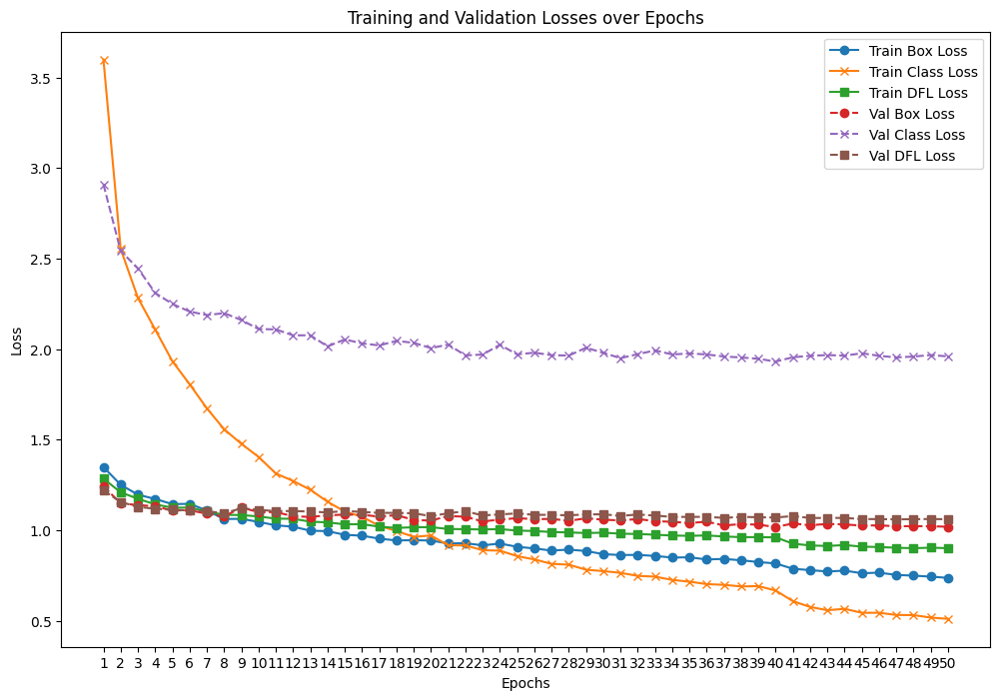

In [15]:
import matplotlib.pyplot as plt
import pandas as pd

# Read the log file into a DataFrame
log_file = 'runs/detect/train/results.csv'
log_data = pd.read_csv(log_file)

# Convert necessary columns to numeric
log_data['epoch'] = pd.to_numeric(log_data['epoch'], errors='coerce').astype(int)  # Convert to integer
log_data['train/box_loss'] = pd.to_numeric(log_data['train/box_loss'], errors='coerce')
log_data['train/cls_loss'] = pd.to_numeric(log_data['train/cls_loss'], errors='coerce')
log_data['train/dfl_loss'] = pd.to_numeric(log_data['train/dfl_loss'], errors='coerce')
log_data['val/box_loss'] = pd.to_numeric(log_data['val/box_loss'], errors='coerce')
log_data['val/cls_loss'] = pd.to_numeric(log_data['val/cls_loss'], errors='coerce')
log_data['val/dfl_loss'] = pd.to_numeric(log_data['val/dfl_loss'], errors='coerce')

# Drop rows with NaN values in relevant columns
log_data = log_data.dropna(subset=['epoch', 'train/box_loss', 'train/cls_loss', 'train/dfl_loss', 
                                   'val/box_loss', 'val/cls_loss', 'val/dfl_loss'])

# Plot the training and validation losses
plt.figure(figsize=(12, 8))

# Plot training losses
plt.plot(log_data['epoch'], log_data['train/box_loss'], label='Train Box Loss', linestyle='-', marker='o')
plt.plot(log_data['epoch'], log_data['train/cls_loss'], label='Train Class Loss', linestyle='-', marker='x')
plt.plot(log_data['epoch'], log_data['train/dfl_loss'], label='Train DFL Loss', linestyle='-', marker='s')

# Plot validation losses
plt.plot(log_data['epoch'], log_data['val/box_loss'], label='Val Box Loss', linestyle='--', marker='o')
plt.plot(log_data['epoch'], log_data['val/cls_loss'], label='Val Class Loss', linestyle='--', marker='x')
plt.plot(log_data['epoch'], log_data['val/dfl_loss'], label='Val DFL Loss', linestyle='--', marker='s')

# Customize the plot
plt.title('Training and Validation Losses over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.xticks(log_data['epoch'])  # Ensure that the epoch ticks are shown as integers
plt.legend(loc='upper right')

# Show the plot
plt.show()


# Validation results

In [16]:
results = model.val()  # Evaluate on the validation set
print(f"Validation Results: {results}")


Ultralytics 8.3.170 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,132,550 parameters, 0 gradients, 28.5 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1059.1±331.8 MB/s, size: 29.2 KB)


val: Scanning /kaggle/working/valid/labels.cache... 1704 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1704/1704 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   2%|▏         | 1/54 [00:00<00:51,  1.03it/s]Exception in thread Thread-43 (plot_images):
Traceback (most recent call last):
  File "/usr/lib/python3.10/threading.py", line 1016, in _bootstrap_inner
    self.run()
  File "/usr/lib/python3.10/threading.py", line 953, in run
    self._target(*self._args, **self._kwargs)
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/utils/plotting.py", line 842, in plot_images
    annotator.im.save(fname)  # save
  File "/usr/local/lib/python3.10/dist-packages/PIL/Image.py", line 2605, in save
    self.encoderinfo = {**im._default_encoderinfo, **encoderinfo}
  File "/usr/local/lib/python3.10/dist-packages/PIL/JpegImagePlugin.py", line 850, in _save
    ImageFile._save(
  File "/usr/local/lib/python3.10/dist-packages/PIL

                   all       1704       4830      0.663      0.369      0.404      0.311
        Aluminium foil         48         62      0.868      0.468      0.536      0.415
            Bottle cap        347        459      0.683      0.671      0.695      0.546
                Bottle        275        320      0.781      0.424      0.542      0.351
          Broken glass         13        123      0.497     0.0569     0.0609     0.0326
                   Can        187        267       0.74      0.682      0.734      0.605
                Carton        207        263      0.569       0.49      0.481      0.416
             Cigarette        223        565      0.661      0.136      0.189     0.0924
                   Cup        162        186      0.562      0.554      0.577      0.469
                   Lid         82         93      0.845      0.441      0.511       0.42
          Other litter        148        178      0.695      0.247      0.268       0.22
         Other plasti

In [17]:
print("Validation Results:")
print("Mean Precision:", results.box.mp)  # Mean Precision
print("Mean Recall:", results.box.mr)  # Mean Recall
print("mAP 50:", results.box.map50)  # Mean Average Precision at IoU 0.5
print("mAP 50-95:", results.box.map)  # Mean Average Precision at IoU 0.5-0.95


Validation Results:
Mean Precision: 0.6627451212392926
Mean Recall: 0.369419159931369
mAP 50: 0.40407334693348385
mAP 50-95: 0.31078423896902374


# Saving best model

In [18]:
best_model = YOLO('runs/detect/train/weights/best.pt')

# Validation Metrics plot

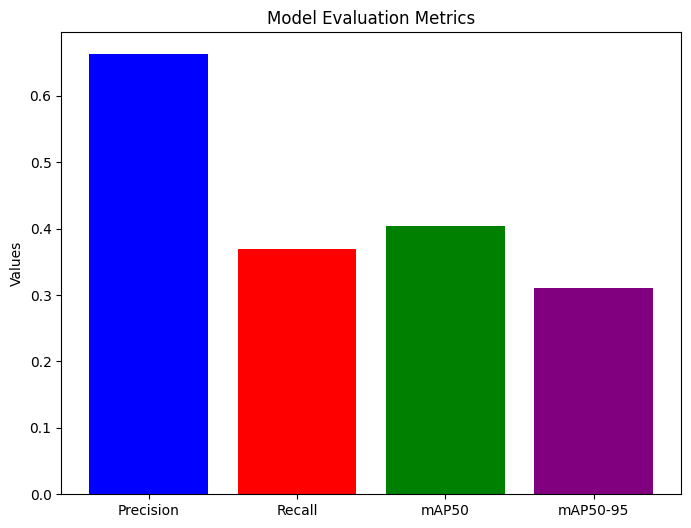

In [19]:
import matplotlib.pyplot as plt

# Scalar values from results_dict
precision = results.results_dict['metrics/precision(B)']
recall = results.results_dict['metrics/recall(B)']
map50 = results.results_dict['metrics/mAP50(B)']
map50_95 = results.results_dict['metrics/mAP50-95(B)']

# Plotting single values (snapshot)
metrics = ['Precision', 'Recall', 'mAP50', 'mAP50-95']
values = [precision, recall, map50, map50_95]

plt.figure(figsize=(8, 6))
plt.bar(metrics, values, color=['b', 'r', 'g', 'purple'])
plt.title('Model Evaluation Metrics')
plt.ylabel('Values')
plt.show()


# Testing

In [20]:
best_model = YOLO('runs/detect/train/weights/best.pt')
test_results = best_model.val(data='data.yaml', split='test')


Ultralytics 8.3.170 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,132,550 parameters, 0 gradients, 28.5 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 871.7±230.1 MB/s, size: 32.1 KB)


val: Scanning /kaggle/working/test/labels... 100 images, 0 backgrounds, 0 corrupt: 100%|██████████| 100/100 [00:00<00:00, 1034.96it/s]

val: New cache created: /kaggle/working/test/labels.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  14%|█▍        | 1/7 [00:00<00:03,  1.93it/s]Exception in thread Thread-56 (plot_images):
Traceback (most recent call last):
  File "/usr/lib/python3.10/threading.py", line 1016, in _bootstrap_inner
    self.run()
  File "/usr/lib/python3.10/threading.py", line 953, in run
    self._target(*self._args, **self._kwargs)
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/utils/plotting.py", line 842, in plot_images
    annotator.im.save(fname)  # save
  File "/usr/local/lib/python3.10/dist-packages/PIL/Image.py", line 2605, in save
    self.encoderinfo = {**im._default_encoderinfo, **encoderinfo}
  File "/usr/local/lib/python3.10/dist-packages/PIL/JpegImagePlugin.py", line 850, in _save
    ImageFile._save(
  File "/usr/local/lib/python3.10/dist-packages/PIL/ImageFile.py", line 556, in _save
    
  File "/usr/local/lib/python3.10/dist-packages/PIL/ImageFile.py", line 574, in _encode_tile
  

                   all        100        394      0.906       0.64      0.706      0.564
        Aluminium foil          1          6      0.887          1      0.995      0.812
            Bottle cap         24         26      0.946      0.846      0.921      0.719
                Bottle         12         13          1      0.454      0.606      0.376
          Broken glass          1         51      0.786      0.314      0.461      0.145
                   Can          8         19      0.941      0.842      0.947       0.74
                Carton         14         30          1      0.617      0.691      0.631
             Cigarette         16         55          1      0.132      0.274      0.143
                   Cup         15         19      0.922      0.895      0.898      0.753
                   Lid          3          4      0.918          1      0.995      0.904
          Other litter          7          7      0.888      0.714      0.732      0.645
         Other plasti

In [21]:
# Print test metrics
print(f"Test Precision: {test_results.box.mp:.4f}")
print(f"Test Recall: {test_results.box.mr:.4f}")
print(f"Test mAP@50: {test_results.box.map50:.4f}")
print(f"Test mAP@50-95: {test_results.box.map:.4f}")

Test Precision: 0.9060
Test Recall: 0.6398
Test mAP@50: 0.7063
Test mAP@50-95: 0.5638


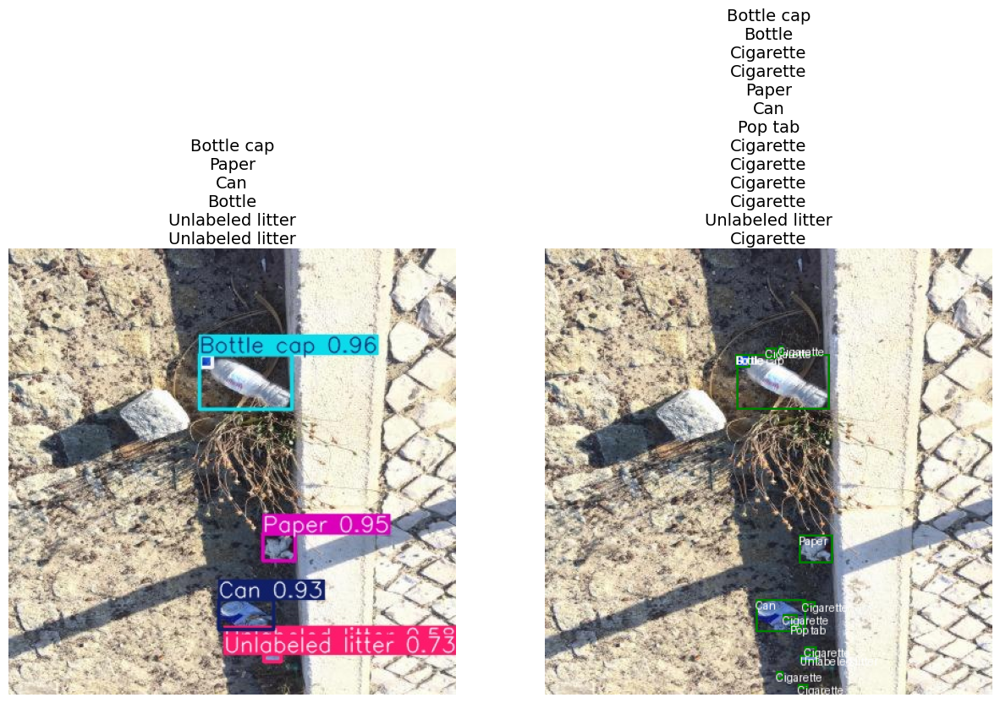

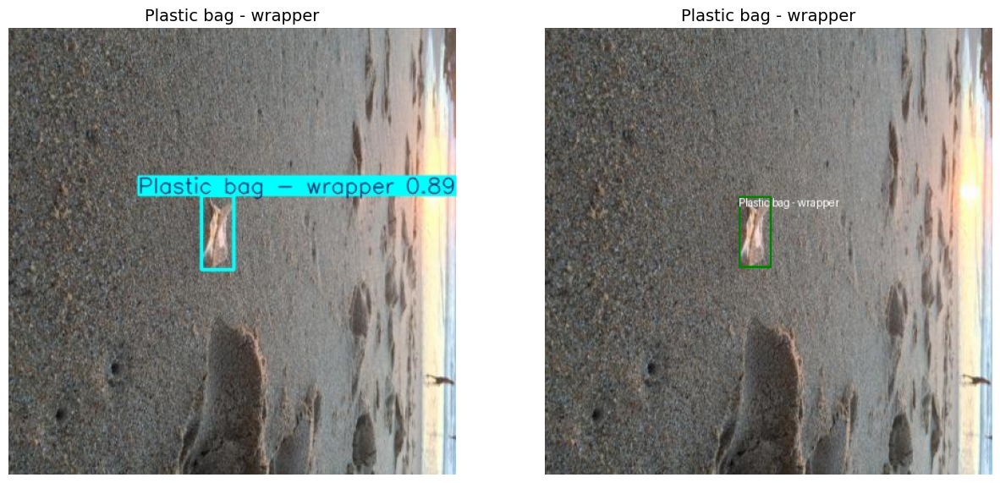

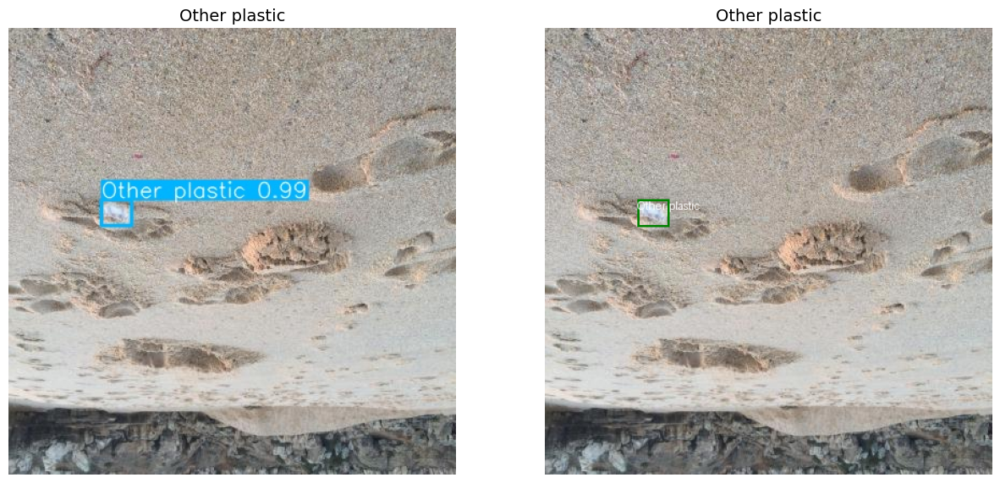

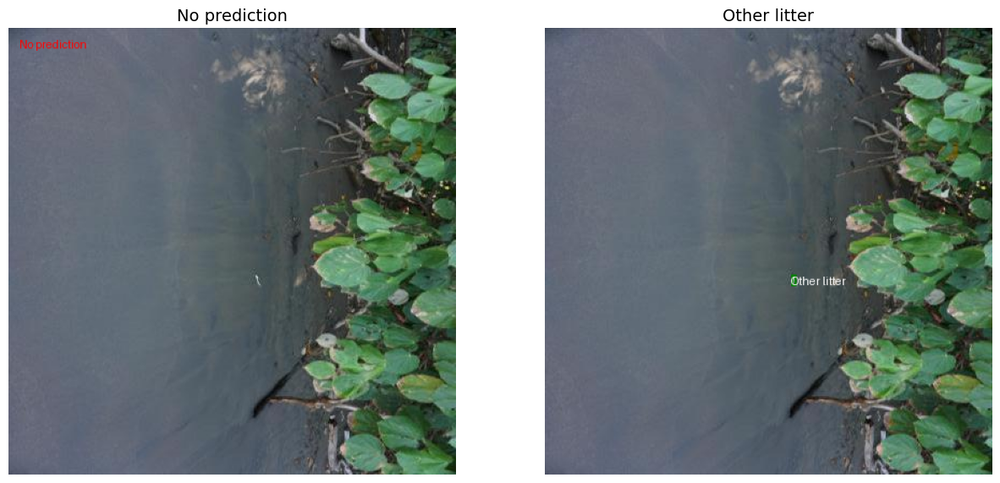

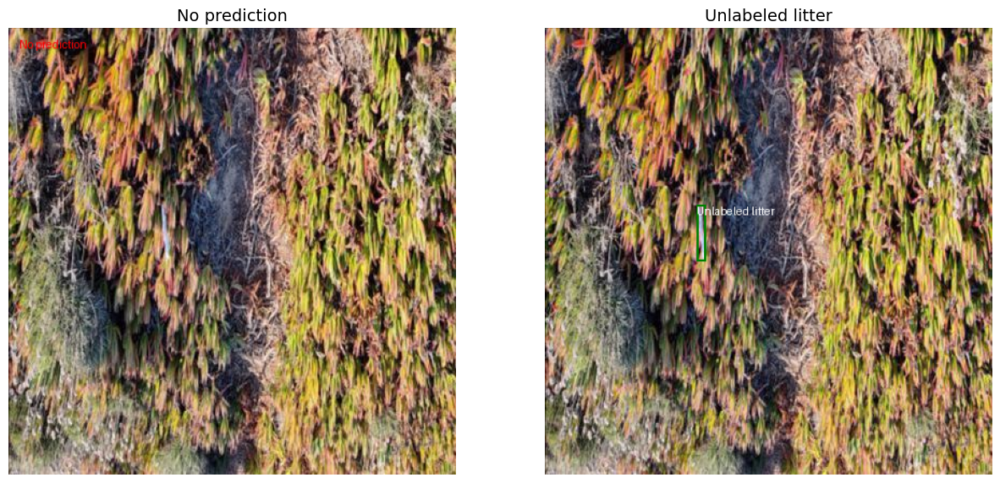

...

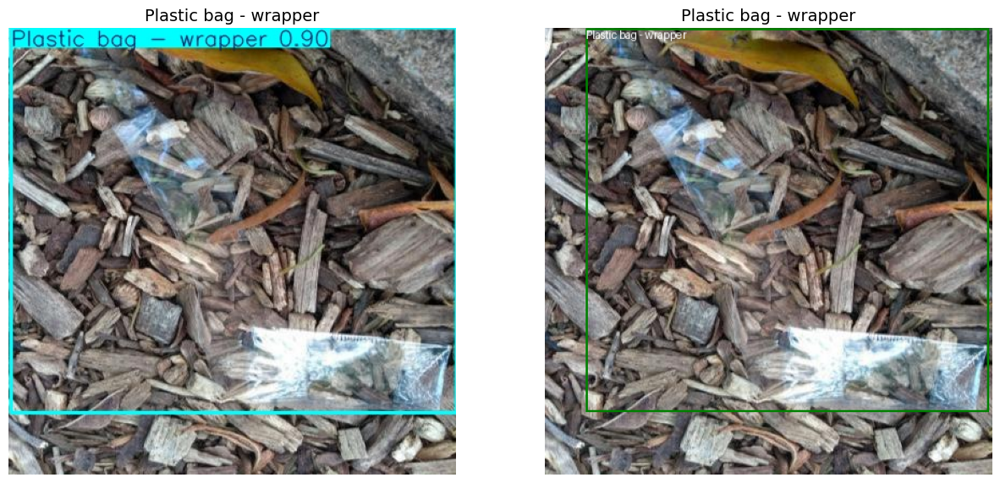

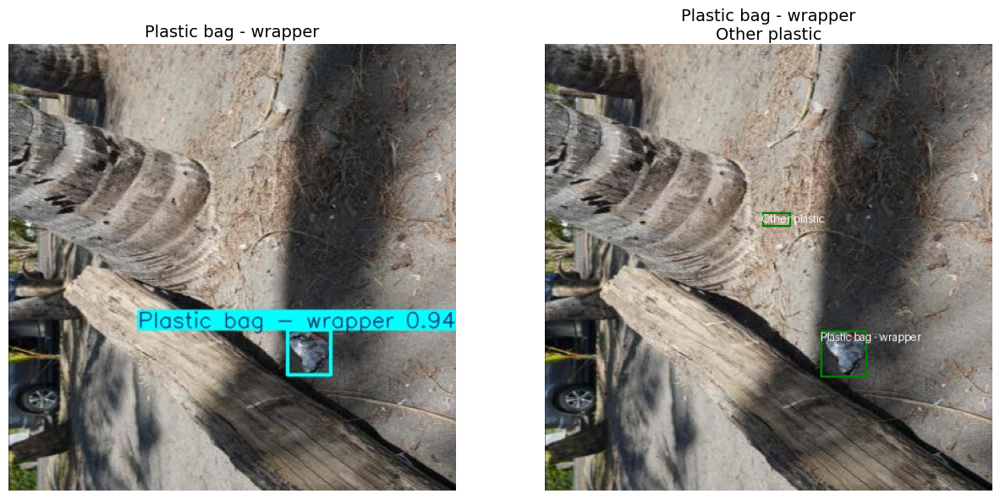

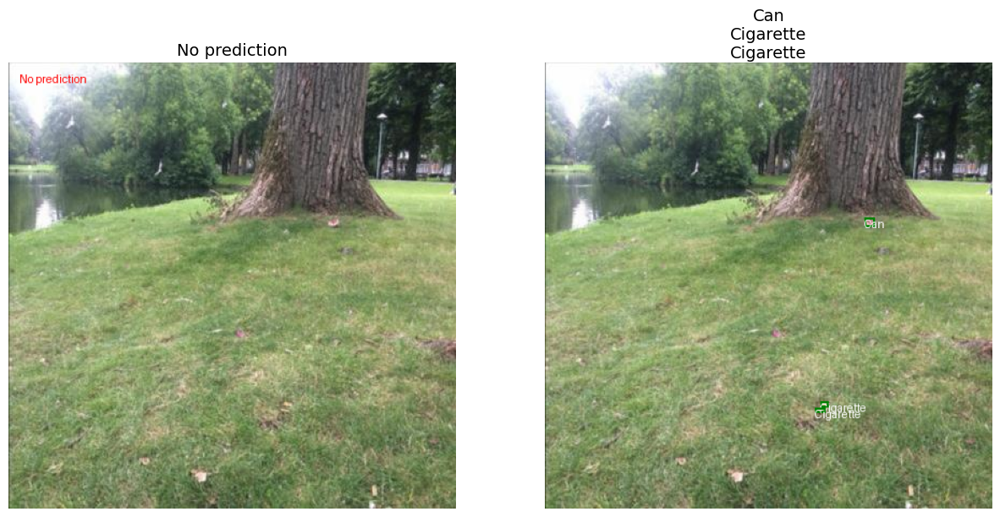

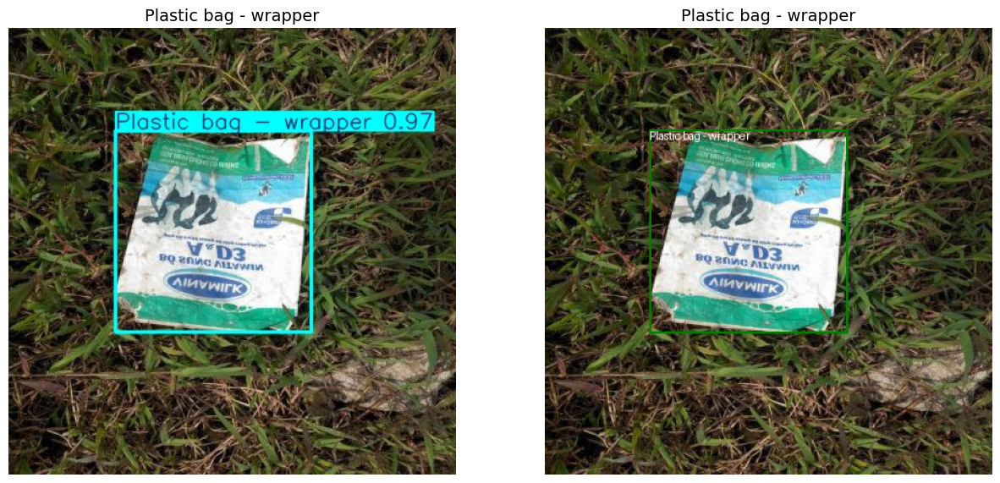

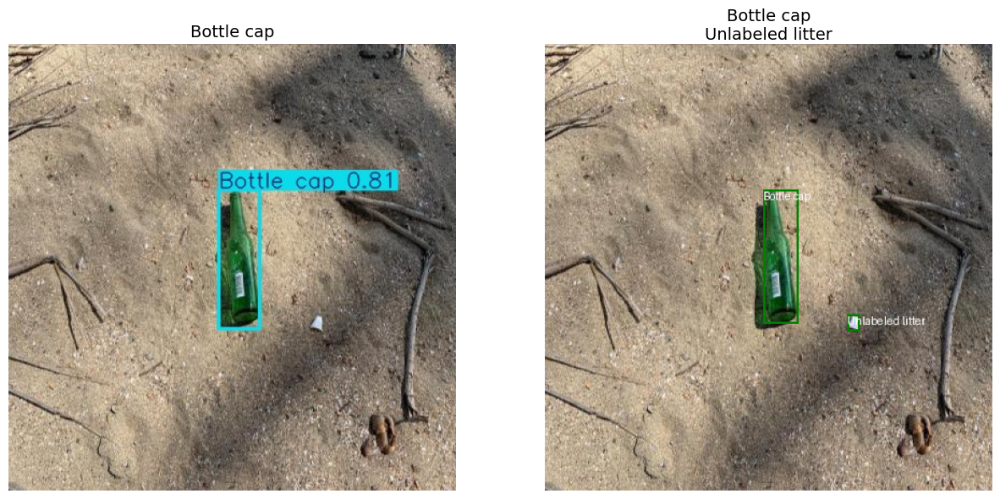

In [ ]:
import os
import glob
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
from ultralytics import YOLO

# Function to parse ground truth annotations in YOLO format
def parse_annotation(annotation_path):
    """
    Parses a YOLO-style annotation file and extracts the class IDs and bounding box information.
    """
    if not os.path.exists(annotation_path):
        print(f"Annotation file {annotation_path} not found.")
        return [], []  # Return empty lists if annotation file is missing
    
    with open(annotation_path, 'r') as file:
        lines = file.readlines()
    
    labels = []
    boxes = []
    for line in lines:
        parts = line.strip().split()
        class_id = int(parts[0])  # Class ID
        # YOLO format: class_id, x_center, y_center, width, height
        box = [float(x) for x in parts[1:]]  # Bounding box: [x_center, y_center, width, height]
        labels.append(class_id)
        boxes.append(box)
    return labels, boxes

# Load the YOLO model
model = YOLO('runs/detect/train/weights/best.pt')

# Path to the test images and corresponding labels (annotations)
test_image_dir = '/kaggle/input/taco-dataset-yolo-format/test/images/'
test_label_dir = '/kaggle/input/taco-dataset-yolo-format/test/labels/'

# Get the list of test images
test_images = glob.glob(os.path.join(test_image_dir, '*.jpg'))  # Adjust for correct extension if needed

# Output directory to save inference results
output_dir = "/kaggle/working/inference_results/"
os.makedirs(output_dir, exist_ok=True)

# Class names 
class_names = ['Aluminium foil', 'Bottle cap', 'Bottle', 'Broken glass', 'Can', 
               'Carton', 'Cigarette', 'Cup', 'Lid', 'Other litter', 'Other plastic', 
               'Paper', 'Plastic bag - wrapper', 'Plastic container', 'Pop tab', 
               'Straw', 'Styrofoam piece', 'Unlabeled litter']

# Loop through each image and perform inference
for img_path in test_images:
    # Get the corresponding annotation file (in YOLO format)
    annotation_path = os.path.join(test_label_dir, os.path.basename(img_path).replace(".jpg", ".txt").replace(".JPG", ".txt"))
    
    # Perform inference without verbose output
    results = model(img_path, verbose=False)  # Run YOLOv8 on the image
    
    # Get actual labels (ground truth) from annotation file
    actual_labels, actual_boxes = parse_annotation(annotation_path)
    actual_labels_names = [class_names[label] for label in actual_labels]
    
    # Save the result image with predictions
    img_name = os.path.basename(img_path)
    result_img_path = os.path.join(output_dir, img_name)
    results[0].save(result_img_path)
    
    # Extract predicted labels and bounding boxes
    if results[0].boxes is None or len(results[0].boxes.cls) == 0:
        predicted_labels = ["No prediction"]
        predicted_boxes = []
    else:
        predicted_labels = [results[0].names[int(cls)] for cls in results[0].boxes.cls]
        predicted_boxes = results[0].boxes.xywh.cpu().numpy()  # Ensure numpy format for further processing
    
    # Open the original image for proper ground truth visualization
    img_predicted = Image.open(result_img_path)
    img_actual = Image.open(img_path)  # Reload the original image for ground truth
    
    # Create drawing objects
    draw_predicted = ImageDraw.Draw(img_predicted)
    draw_actual = ImageDraw.Draw(img_actual)
    
    # Draw predicted bounding boxes (blue) on the predicted image
    img_width, img_height = img_predicted.size
    if len(predicted_boxes) == 0:  # Check if predicted_boxes is empty
        draw_predicted.text((10, 10), "No prediction", fill="red")
    else:
        for i, box in enumerate(predicted_boxes):
            x_center, y_center, width, height = box
            x1 = int((x_center - width / 2) * img_width)
            y1 = int((y_center - height / 2) * img_height)
            x2 = int((x_center + width / 2) * img_width)
            y2 = int((y_center + height / 2) * img_height)
            draw_predicted.rectangle([x1, y1, x2, y2], outline="blue", width=2)
            draw_predicted.text((x1, y1), predicted_labels[i] if i < len(predicted_labels) else "Unknown", fill="blue")
    
    # Draw ground truth bounding boxes (green) on the actual image
    for i, box in enumerate(actual_boxes):
        x_center, y_center, width, height = box
        x1 = int((x_center - width / 2) * img_width)
        y1 = int((y_center - height / 2) * img_height)
        x2 = int((x_center + width / 2) * img_width)
        y2 = int((y_center + height / 2) * img_height)
        draw_actual.rectangle([x1, y1, x2, y2], outline="green", width=2)
        draw_actual.text((x1, y1), actual_labels_names[i], fill="white")
    
    # Display images side by side
    fig, axes = plt.subplots(1, 2, figsize=(15, 7))
    
    axes[0].imshow(img_predicted)
    axes[0].set_title("\n".join(predicted_labels), fontsize=14, wrap=True)
    axes[0].axis("off")
    
    axes[1].imshow(img_actual)
    axes[1].set_title("\n".join(actual_labels_names), fontsize=14, wrap=True)
    axes[1].axis("off")
    
    plt.show()


In [ ]:
from ultralytics import YOLO

# Load your model
model = YOLO('/kaggle/working/runs/detect/train/weights/best.pt')  # path to your trained model

# Run inference on the video
results = model.predict(source="/kaggle/input/video-for-infrence/other/default/1/WhatsApp Video 2025-07-28 at 12.01.35_4b20a4d7.mp4", save=True)  # saves annotated video in runs/detect

# Find and display the result video
import os
from IPython.display import Video

output_path = "runs/detect/predict/WhatsApp Video 2025-07-28 at 12.01.35_4b20a4d7 Infrences.mp4"
if os.path.exists(output_path):
    Video(output_path)
else:
    print("Output video not found.")



WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/501) /kaggle/input/video-for-infrence/other/default/1/WhatsApp Video 2025-07-28 at 12.01.35_4b20a4d7.mp4: 384x640 (no detections), 41.6ms
video 1/1 (frame 2/501) /kaggle/input/video-for-infrence/other/default/1/WhatsApp Video 2025-07-28 at 12.01.35_4b20a4d7.mp4: 384x640 (no detections), 10.7ms
video 1/1 (frame 3/501) /kaggle/input/video-for-infrence/other/default/1/WhatsApp Video 2025-07-28 at 12.01.35_4b20a4d7.mp4: 384x640 (no detec

In [ ]:
from ultralytics import YOLO

# Load your model
model = YOLO('/kaggle/working/runs/detect/train/weights/best.pt')  # path to your trained model

# Run inference on the video
results = model.predict(source="/kaggle/input/video-for-infrence/other/default/1/WhatsApp Video 2025-07-28 at 12.01.35_fd48bd0c.mp4", save=True)  # saves annotated video in runs/detect

# Find and display the result video
import os
from IPython.display import Video

output_path = "runs/detect/predict/WhatsApp Video 2025-07-28 at 12.01.35_fd48bd0c Infrence.mp4"
if os.path.exists(output_path):
    Video(output_path)
else:
    print("Output video not found.")



WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/3942) /kaggle/input/video-for-infrence/other/default/1/WhatsApp Video 2025-07-28 at 12.01.35_fd48bd0c.mp4: 640x320 1 Plastic bag - wrapper, 40.3ms
video 1/1 (frame 2/3942) /kaggle/input/video-for-infrence/other/default/1/WhatsApp Video 2025-07-28 at 12.01.35_fd48bd0c.mp4: 640x320 1 Plastic bag - wrapper, 10.4ms
video 1/1 (frame 3/3942) /kaggle/input/video-for-infrence/other/default/1/WhatsApp Video 2025-07-28 at 12.01.35_fd48bd0c.mp4